# Decentralized tunnel passing

In [4]:
import sys
sys.path.append('../')
from panav.env import NavigationEnv, Box2DRegion, PolygonRegion, box_2d_center, line_seg_to_obstacle
from panav.viz import draw_env
from panav.tunnels import detect_tunnels

import shapely
import numpy as np
from matplotlib import pyplot as plt

from shapely.plotting import plot_polygon, plot_points, plot_line
from shapely import Polygon,LineString,Point


%load_ext autoreload
%autoreload 2

from panav.SAMP import SA_MILP_Planning
from panav.util import unique_tx, interpolate_positions

In [193]:

bloating_r = 0.5

d = 2
K = 10
t0 = 0
vmax = 1.0
interp_dt = 0.1

In [195]:

start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

start_locs = np.array([[5,1],[-5,-1]])*1.0
goal_locs = np.array([[-5,1],[5,-1]])*1.0

starts = [box_2d_center(s,start_box_side) for s in start_locs]
goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

O1 = Box2DRegion((-2.5,2.5),(0.5,10))
O2 = Box2DRegion((-2.5,2.5),(-10,-1.0))


limits = [(-10.0,10.0),(-10.0,10.0)]

bloating_r = 0.5 

env = NavigationEnv(limits,[O1,O2],starts,goals)

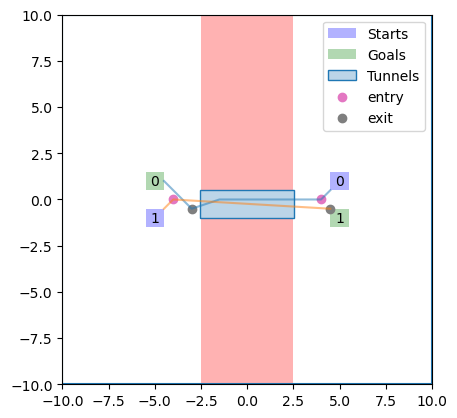

In [69]:
from panav.tunnels import get_entry_exit
ax = plt.gca()

draw_env(env,xs,ax)

# plot_line(face,ax=ax)
labeled = False
tunnels = detect_tunnels(env,bloating_r)
for tunnel in tunnels:
    plot_polygon(tunnel.region,ax=ax,label='Tunnels' if not labeled else None,add_points =False)
    labeled=True


entry = []
exit = []

for x in xs:
    ent,ex = get_entry_exit(tunnels[0],x)
    
    entry+=ent
    
    exit+=ex

entry = np.vstack(entry)
exit = np.vstack(exit)

plt.scatter(entry[:,0],entry[:,1],label='entry')
plt.scatter(exit[:,0],exit[:,1],label='exit')

plt.legend()
plt.show()

# Navigation experiments

In [71]:
from panav.ORCA import ORCA_Agent

# Control group: Navigation without passing protocol

In [137]:
agents = np.arange(len(starts))
ts = []
xs = []
for go_agent in agents:
    start = env.starts[go_agent]
    goal = env.goals[go_agent]
    t,x = SA_MILP_Planning(env,start,goal,vmax,bloating_r,\
                                     [],\
                                    d,K,t0)
    t,x = unique_tx(t,x)
    ts.append(t)
    xs.append(x)

tau = 2.0 # The safe time interval. Can be generously long.
exec_tau = 0.05 * tau 
##### Important:
#  For deadlock resolution by right-hand-rule to work,
#  need to ensure exec_tau * vmax >> bloating_r,
#  otherwise, the agents can trap in livelock, i.e., 
#  getting in and out of deadlock repeatedly.
#####

detection_radius = bloating_r * 5

# The execution time of ORCA velocity.
# Can be shorter than the safe interval tau.

pos = []
vs = [np.zeros(start_locs[0].shape) for a in agents]
v_prefs = [np.zeros(start_locs[0].shape) for a in agents]

protocol = 0

orcas = [ORCA_Agent(protocol,tau,bloating_r,vmax,np.array(p),v) 
         for p,v in zip(start_locs,vs)]

curr_wp_index = [0 for a in agents]

makespans = np.zeros(len(agents))

curr_time = 0

plans = xs
agents = set(np.arange(len(starts)))

for _ in range(400):
    pos.append(np.array([a.p for a in orcas]))
    
    # Compute the preferred velocity.
    for agent in agents:
        wp = plans[agent][:,curr_wp_index[agent]]
        to_wp = wp-orcas[agent].p
        
        # See if the agent has reached the current waypoint.
        if np.linalg.norm(to_wp)<= bloating_r:  
            curr_wp_index[agent] = \
            np.min([curr_wp_index[agent]+1,   
                    plans[agent].shape[1]-1
                                  ])

        
        v_prefs[agent] = vmax * to_wp / np.linalg.norm(to_wp)
    
    # Update v_opt
    for a in agents:
        orcas[a].update_v_opt(v_prefs[a])
    
    # Compute the safe velocity.
    for a in agents:   
        neighbors = [b for b in agents-{a}
            if np.linalg.norm(orcas[a].p-orcas[b].p)<= detection_radius]
        
        orcas[a].update_v(v_prefs[a],env.obstacles,
                        [orcas[b] for b in neighbors],
                         right_hand_rule=False)
    
    # Execute the safe velocity.
    all_reached = True
    curr_time +=exec_tau
    for a in agents:
        if np.linalg.norm(orcas[a].p \
                        - goals[a].project(orcas[a].p))\
                        >=1*bloating_r:
            orcas[a].p += orcas[a].v*exec_tau
            all_reached = False
            makespans[a] = curr_time
    
    
    if all_reached:
        break

/Users/tianpengzhang/opt/miniconda3/envs/PA-Nav/lib/python3.11/site-packages/cvxpy/problems/problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


In [138]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.05
pos = np.array(pos)

pos_to_ani = [pos[:,a,:].T for a in agents]
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
anim.save('no_passing_protocol.gif')
plt.close() 

# Navigation with passing protocol

In [196]:
agents = np.arange(len(starts))
ts = []
xs = []
for go_agent in agents:
    start = env.starts[go_agent]
    goal = env.goals[go_agent]
    t,x = SA_MILP_Planning(env,start,goal,vmax,bloating_r,\
                                     [],\
                                    d,K,t0)
    t,x = unique_tx(t,x)
    ts.append(t)
    xs.append(x)


tunnels = detect_tunnels(env,bloating_r)

agents = set(np.arange(len(starts)))

passage = {a:[] for a in agents}

for a,x in zip(agents,xs):
    ent,ex = get_entry_exit(tunnels[0],x)
    # print(ent,ex)
    passage[a]+= [(*ent,*ex)]
    
next_passage = {a:passage[a].pop(0) for a in agents}


/Users/tianpengzhang/opt/miniconda3/envs/PA-Nav/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


In [197]:

tau = 2.0 # The safe time interval. Can be generously long.
exec_tau = 0.1 * tau 
##### Important:
#  For deadlock resolution by right-hand-rule to work,
#  need to ensure exec_tau * vmax >> bloating_r,
#  otherwise, the agents can trap in livelock, i.e., 
#  getting in and out of deadlock repeatedly.
#####

detection_radius = bloating_r * 5

# The execution time of ORCA velocity.
# Can be shorter than the safe interval tau.

pos = []
vs = [np.zeros(start_locs[0].shape) for a in agents]
v_prefs = [np.zeros(start_locs[0].shape) for a in agents]

protocol = 0

orcas = [ORCA_Agent(protocol,tau,bloating_r,vmax,np.array(p),v) 
         for p,v in zip(start_locs,vs)]

curr_wp_index = [0 for a in agents]

makespans = np.zeros(len(agents))

curr_time = 0

plans = xs

tunnel = tunnels[0]

waiting_now = {a:False for a in agents}

reached = {a:False for a in agents}

for _ in range(1500):
    pos.append(np.array([a.p for a in orcas]))
    
    # Compute the preferred velocity.
    for agent in agents:
        wp = plans[agent][:,curr_wp_index[agent]]
        to_wp = wp-orcas[agent].p

        # See if the agent has reached the current waypoint.
        if np.linalg.norm(to_wp)<= exec_tau*vmax:  
            curr_wp_index[agent] = \
            np.min([curr_wp_index[agent]+1,   
                    plans[agent].shape[1]-1
                                  ])
 
        if next_passage[agent] is not None:
            ent_fid,ent_wpid,ent_loc,ex_fid,ex_wpid,ex_loc \
            = next_passage[agent]

            # See if the agent has come close to the tunnel entrance.
            if np.linalg.norm(ent_loc-orcas[agent].p)<=detection_radius\
            and agent not in tunnel.passing[(ent_fid,ex_fid)]:
                if agent not in tunnel.waiting[(ent_fid,ex_fid)]:
                        tunnel.waiting[(ent_fid,ex_fid)].append(agent)
                        # Add the agent to the waiting list

            # See if the agent is at an exit point
            if curr_wp_index[agent]-1 == ex_wpid or reached[agent]:
                
                tunnel.passing[(ent_fid,ex_fid)].remove(agent)

                if len(passage[agent])>0:
                    next_passage[agent] = passage[agent].pop(0)
                else:
                    next_passage[agent] = None


            # print('passing',tunnel.passing[(ent_fid,ex_fid)],tunnel.passing[(ex_fid,ent_fid)])
            if agent in tunnel.waiting[(ent_fid,ex_fid)]:
                if agent == tunnel.waiting[(ent_fid,ex_fid)][0]\
                and len(tunnel.passing[(ex_fid,ent_fid)])==0: # No agent is passing the opposite direction
                    tunnel.waiting[(ent_fid,ex_fid)].remove(agent)
                    tunnel.passing[(ent_fid,ex_fid)].append(agent)

                    waiting_now[agent]  = False
                else:
                    waiting_now[agent] = True
                
        if not waiting_now[agent]:
            v_prefs[agent] = vmax * to_wp / np.linalg.norm(to_wp)
        else:
            v_prefs[agent] = -0.0*vmax * to_wp / np.linalg.norm(to_wp)
            
    # Update v_opt
    for a in agents:
        orcas[a].update_v_opt(v_prefs[a])
    
    # Compute the safe velocity.
    for a in agents:   
        neighbors = [b for b in agents-{a}
            if np.linalg.norm(orcas[a].p-orcas[b].p)<= detection_radius]
        
        orcas[a].update_v(v_prefs[a],env.obstacles,
                        [orcas[b] for b in neighbors],
                         right_hand_rule=True)
    
    # Execute the safe velocity.
    all_reached = True
    curr_time +=exec_tau
    for a in agents:
        if np.linalg.norm(orcas[a].p \
                        - goals[a].project(orcas[a].p))\
                        >=exec_tau*vmax:
            orcas[a].p += orcas[a].v*exec_tau
            all_reached = False
            makespans[a] = curr_time
        else:
            reached[a] = True
    
    
    if all_reached:
        break

In [198]:
from panav.viz import animation
from IPython.display import HTML, display

dt = 0.05
pos = np.array(pos)

pos_to_ani = [pos[:,a,:].T for a in agents]
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
anim.save('with_passing_protocol.gif')
plt.close() 

# N-agent with passing protocol

In [173]:
top, bottom = 6,-6
start_x_offset = 5 
goal_x_offset = 7
N = 5

start_locs = np.vstack([
np.vstack([np.ones(N)*start_x_offset,np.linspace(top,bottom, N)]).T,
np.vstack([np.ones(N)*(-start_x_offset),np.linspace(top,bottom, N)]).T])

goal_locs = np.vstack([
np.vstack([np.ones(N)*(-goal_x_offset),np.linspace(bottom,top, N)]).T,
np.vstack([np.ones(N)*goal_x_offset,np.linspace(bottom,top, N)]).T])


start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])


starts = [box_2d_center(s,start_box_side) for s in start_locs]
goals = [box_2d_center(g,goal_box_side) for g in goal_locs]

O1 = Box2DRegion((-2.5,2.5),(0.5,10))
O2 = Box2DRegion((-2.5,2.5),(-10,-1.0))


limits = [(-10.0,10.0),(-10.0,10.0)]

bloating_r = 0.5 

env = NavigationEnv(limits,[O1,O2],starts,goals)

In [189]:
agents = np.arange(len(starts))
ts = []
xs = []
for go_agent in agents:
    start = env.starts[go_agent]
    goal = env.goals[go_agent]
    t,x = SA_MILP_Planning(env,start,goal,vmax,bloating_r,\
                                     [],\
                                    d,K,t0)
    t,x = unique_tx(t,x)
    ts.append(t)
    xs.append(x)


tunnels = detect_tunnels(env,bloating_r)

agents = set(np.arange(len(starts)))

passage = {a:[] for a in agents}

for a,x in zip(agents,xs):
    ent,ex = get_entry_exit(tunnels[0],x)
    # print(ent,ex)
    passage[a]+= [(*ent,*ex)]
    
next_passage = {a:passage[a].pop(0) for a in agents}


In [ ]:
class TunnelPassingControl:
    def __init__(self,env,agent_plans,bloating_r):
        self.tunnels = detect_tunnels(env,bloaing_r)
        self.agents = set(np.arange(len(agent_plans)))
        self.passage = {a:[] for a in self.agents}
        
        for a,x in zip(self.agents, agent_plans):
            for tun_id, tunnel in enumerate(self,tunnels):
                ent,ex = get_entry_exit(tunnel,x)
                
                if ent is not None and ex is not None:
                    self.passage[a].append((tun_id,*ent,*ex))
        
        self.next_passage = {}
        for a in self.agents:
            self.next_passage[a] = None if len(self.passage[a])==0\
                                    else self.passage[a].pop(0)
    
    def update_passing_state(self,agent,agent_loc,
                             waiting_radius, exit_radius):
        
        next_pass = self.next_passage[agent]
        
        if next_pass is not None:
            tun_id, ent_fid,ent_wpid,ent_loc,ex_fid,ex_wpid,ex_loc \
            = next_pass
            
            tunnel = self.tunnels[tun_id]
            
            # See if the agent has come close to the tunnel entrance.
            if np.linalg.norm(ent_loc-agent_loc)<=waiting_radius\
            and agent not in tunnel.passing[(ent_fid,ex_fid)]:
                if agent not in tunnel.waiting[(ent_fid,ex_fid)]:
                        tunnel.waiting[(ent_fid,ex_fid)].append(agent)
                        # Add the agent to the waiting list

            # print('passing',tunnel.passing[(ent_fid,ex_fid)],tunnel.passing[(ex_fid,ent_fid)])
            if agent in tunnel.waiting[(ent_fid,ex_fid)]:
                if agent == tunnel.waiting[(ent_fid,ex_fid)][0]\
                and len(tunnel.passing[(ex_fid,ent_fid)])==0: # No agent is passing the opposite direction
                    tunnel.waiting[(ent_fid,ex_fid)].remove(agent)
                    tunnel.passing[(ent_fid,ex_fid)].append(agent)
                else:
                    return 'wait'
            
            # See if the agent is at an exit point
            if np.linalg.norm(ex_loc-agent_loc)<=exit_radius:
                
                tunnel.passing[(ent_fid,ex_fid)].remove(agent)

                if len(self.passage[agent])>0:
                    self.next_passage[agent] = self.passage[agent].pop(0)
                else:
                    self.next_passage[agent] = None
                
        return 'pass'

In [191]:

tau = 2.0 # The safe time interval. Can be generously long.
exec_tau = 0.1 * tau 
##### Important:
#  For deadlock resolution by right-hand-rule to work,
#  need to ensure exec_tau * vmax >> bloating_r,
#  otherwise, the agents can trap in livelock, i.e., 
#  getting in and out of deadlock repeatedly.
#####

detection_radius = bloating_r * 5

# The execution time of ORCA velocity.
# Can be shorter than the safe interval tau.

pos = []
vs = [np.zeros(start_locs[0].shape) for a in agents]
v_prefs = [np.zeros(start_locs[0].shape) for a in agents]

protocol = 0

orcas = [ORCA_Agent(protocol,tau,bloating_r,vmax,np.array(p),v) 
         for p,v in zip(start_locs,vs)]

curr_wp_index = [0 for a in agents]

makespans = np.zeros(len(agents))

curr_time = 0

plans = xs

tunnel = tunnels[0]

waiting_now = {a:False for a in agents}

reached = {a:False for a in agents}

for _ in range(1500):
    pos.append(np.array([a.p for a in orcas]))
    
    # Compute the preferred velocity.
    for agent in agents:
        wp = plans[agent][:,curr_wp_index[agent]]
        to_wp = wp-orcas[agent].p

        # See if the agent has reached the current waypoint.
        if np.linalg.norm(to_wp)<= exec_tau*vmax:  
            curr_wp_index[agent] = \
            np.min([curr_wp_index[agent]+1,   
                    plans[agent].shape[1]-1
                                  ])
 
        if next_passage[agent] is not None:
            ent_fid,ent_wpid,ent_loc,ex_fid,ex_wpid,ex_loc \
            = next_passage[agent]

            # See if the agent has come close to the tunnel entrance.
            if np.linalg.norm(ent_loc-orcas[agent].p)<=detection_radius\
            and agent not in tunnel.passing[(ent_fid,ex_fid)]:
                if agent not in tunnel.waiting[(ent_fid,ex_fid)]:
                        tunnel.waiting[(ent_fid,ex_fid)].append(agent)
                        # Add the agent to the waiting list

            # See if the agent is at an exit point
            if curr_wp_index[agent]-1 == ex_wpid or reached[agent]:
                
                tunnel.passing[(ent_fid,ex_fid)].remove(agent)

                if len(passage[agent])>0:
                    next_passage[agent] = passage[agent].pop(0)
                else:
                    next_passage[agent] = None


            # print('passing',tunnel.passing[(ent_fid,ex_fid)],tunnel.passing[(ex_fid,ent_fid)])
            if agent in tunnel.waiting[(ent_fid,ex_fid)]:
                if agent == tunnel.waiting[(ent_fid,ex_fid)][0]\
                and len(tunnel.passing[(ex_fid,ent_fid)])==0: # No agent is passing the opposite direction
                    tunnel.waiting[(ent_fid,ex_fid)].remove(agent)
                    tunnel.passing[(ent_fid,ex_fid)].append(agent)

                    waiting_now[agent]  = False
                else:
                    waiting_now[agent] = True
                
        if not waiting_now[agent]:
            v_prefs[agent] = vmax * to_wp / np.linalg.norm(to_wp)
        else:
            v_prefs[agent] = -0.0*vmax * to_wp / np.linalg.norm(to_wp)
            
    # Update v_opt
    for a in agents:
        orcas[a].update_v_opt(v_prefs[a])
    
    # Compute the safe velocity.
    for a in agents:   
        neighbors = [b for b in agents-{a}
            if np.linalg.norm(orcas[a].p-orcas[b].p)<= detection_radius]
        
        orcas[a].update_v(v_prefs[a],env.obstacles,
                        [orcas[b] for b in neighbors],
                         right_hand_rule=True)
    
    # Execute the safe velocity.
    all_reached = True
    curr_time +=exec_tau
    for a in agents:
        if np.linalg.norm(orcas[a].p \
                        - goals[a].project(orcas[a].p))\
                        >=exec_tau*vmax:
            orcas[a].p += orcas[a].v*exec_tau
            all_reached = False
            makespans[a] = curr_time
        else:
            reached[a] = True
    
    
    if all_reached:
        break

In [192]:
from panav.viz import animation
from IPython.display import HTML, display

import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

dt = 0.05
pos = np.array(pos)

pos_to_ani = [pos[:,a,:].T for a in agents]
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
anim.save('n_agent_passing.gif')
plt.close() 


# Items

Tunnel class. Single tunnel.
1. region: shapely polygon
2. freefaces: shapely linestrings, faces of the polygon that does not intersect with any obstacles or other tunnels(require a list of tunnel objects)
3. passage: {(free face id1, free face id2): waitlist, passinglist}
4. Method: inout(waypoint1, waypoint2, freeface): output 0 if wp1-wp2 does not intersect with free face. -1 if wp1-wp2 comes out the tunnel. +1 if goes into the tunnel. Determine +-1 using the perp vector of freeface.
5. Method: get_passage(PWL of the agent). Return the corresponding waitlist and passing list.

PWL of the agent:

some segments of the PWL are marked as hard, other soft. Hard segments go through a tunnel/a connected tunnel network. Hard segments starts with a wait wp, the agent should wait at this wp before enter the tunnel/tunnel network.

AttributeError: 'Tunnel' object has no attribute 'exterior'

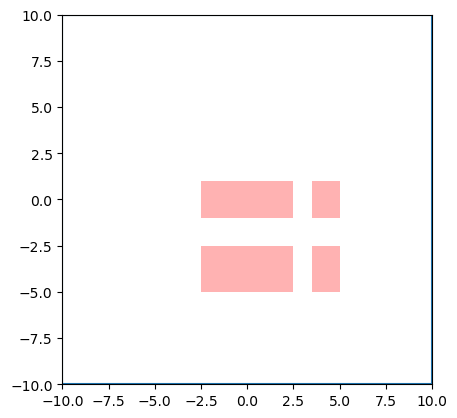

In [40]:
start_box_side = np.array([1,1])
goal_box_side = np.array([1,1])

o1 = Box2DRegion((-2.5,2.5),(-1.0,1.0))
o2 = Box2DRegion((-2.5,2.5),(-5,-2.5))

o3 = Box2DRegion((3.5,5),(-5,-2.5))

o4 = Box2DRegion((3.5,5),(-1.0,1.0))

obstacles = [o1,o2,o3,o4]

limits = [(-10.0,10.0),(-10.0,10.0)]

bloating_r = 0.5 

env = NavigationEnv(limits,obstacles,[],[])

ax = plt.gca()

draw_env(env,ax=ax)
        

labeled = False
tunnels = detect_tunnels(env,bloating_r)
for tunnel in tunnels:
    plot_polygon(tunnel,ax=ax,label='Tunnels' if not labeled else None,add_points =False)
    labeled=True
    
ax.legend()
plt.show()